## Computer Vision Assignment 
### Student Id:-2833155
### Module id :- 30241

## Problem statement 
### We are required to segment the brain regions. We have 10 consecutive axial cross section for publicily available MRI data. It contains T1 weighted MRI images with z-slice being at 1 mm interval.
### We have region labels in the figure.
<ol>
    Label 0 = Air
</ol>
<ol>
    Label 1 = skin/scalap
</ol>
<ol>
    Label 2 = skull
</ol>
<ol>
    Label 3 = CSF
</ol>
<ol>
    Label 4 = Gray Matter
</ol>

<ol>
    Label 5 = White Matter
</ol>

===============================================================

## Task 1: 2D tissue segmentation 
## Develop and apply different segmentation algorithms, based on any technique you have learnt to each slice of the MRI data. You need to apply exactly the same algorithm to every slice. HINT: This will more than likely be a combination of different techniques

======================================

## Methodologies 

## Approach 1. Semi Automted method 
<ol><b>Thresholding</b></ol>
<ol><b>Thresholding with smoothing</b></ol>


## Approach 2 Semi Automated method 2
<ol>K-means clustering</ol>

In [1]:
## loading libraries 
import pandas as pd 
import numpy as np 
import sys
import scipy
import skimage 
import torch
import torchvision 
import cv2
import matplotlib.pyplot as plt 
from matplotlib.colors import ListedColormap

In [2]:
## uploading brain images 
Brain_image = scipy.io.loadmat('Brain (1).mat')

In [3]:
Brain_arr = Brain_image['T1']

In [4]:
label = Brain_image['label']

## Image and ground truth label

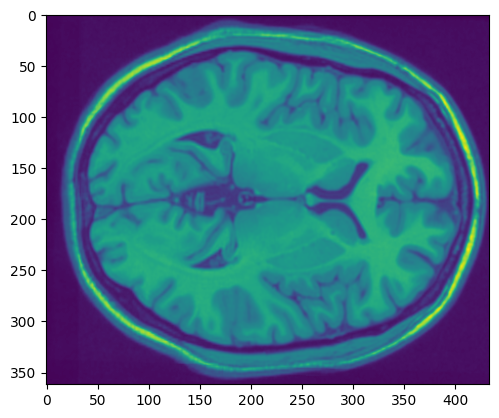

In [5]:
## checking the brain image and ground truth segmentation for first slice
plt.imshow(Brain_arr[:,:,0]);

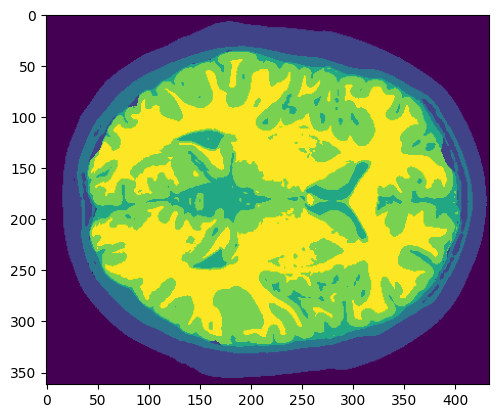

In [6]:
plt.imshow(label[:,:,0]);

===================================================================

## Shape of the brain image 

In [7]:
Brain_arr.shape

(362, 434, 10)

In [8]:
height,width , depth = Brain_arr.shape

## First representation of all images in one shot

In [9]:
def Visual_Represetation_Img(arr:np.array):
    ## Visualise all the 10 brain images to understand the differences manually
    ## Resizing the imgae 
    plt.figure(figsize=(15, 5)) 
    # no_of_images = arr.shape[2]
    no_of_images = 10
    for index in range(0,no_of_images):
        plt.subplot(1, no_of_images,index+1)
        plt.imshow(arr[:,:,index])
        plt.title(f"image:{index}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()
    

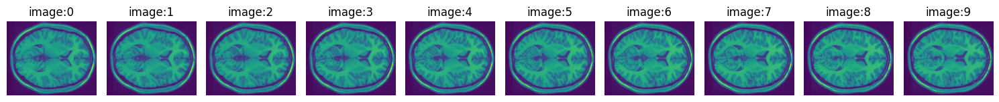

In [10]:
## calling the function 
if __name__ == "__main__":
    Visual_Represetation_Img(Brain_arr)

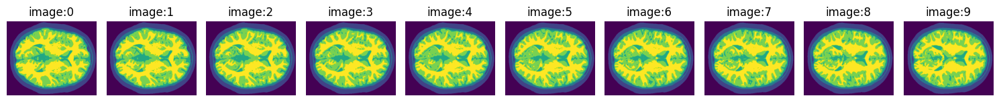

In [11]:
Visual_Represetation_Img(label)

========================================================

## Aprroach 1: Thresholding method 

In [12]:
## Semi Automated Method
def img_to_hist(img:np.array):
    ## will create the each image to single dim arr
    ## represent each imgae histogram
    plt.figure(figsize=(15, 5))
    no_of_img = img.shape[2]
    for img_index in range(no_of_img):
        img_arr = img[:,:,img_index]
        max_pixel = np.max(img_arr)
        min_pixel = np.min(img_arr)

        img_rescaling = ((img_arr - min_pixel)/(max_pixel-min_pixel)*255).astype(np.uint8)
        ## img_arr.ravel()
        # Flat_img_arr = img_arr.reshape(1,img_arr.shape[0]*img_arr.shape[1])
        Flat_img_arr = img_rescaling.ravel()
        Flat_img_Arr = Flat_img_arr
        plt.subplot(3,4,img_index+1)
        # plt.plot(Flat_img_Arr)
        plt.hist(Flat_img_Arr, bins=256, range=(0, 255), color='blue', alpha=0.7)
        plt.title(f"Histogram of image:{img_index}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()
        

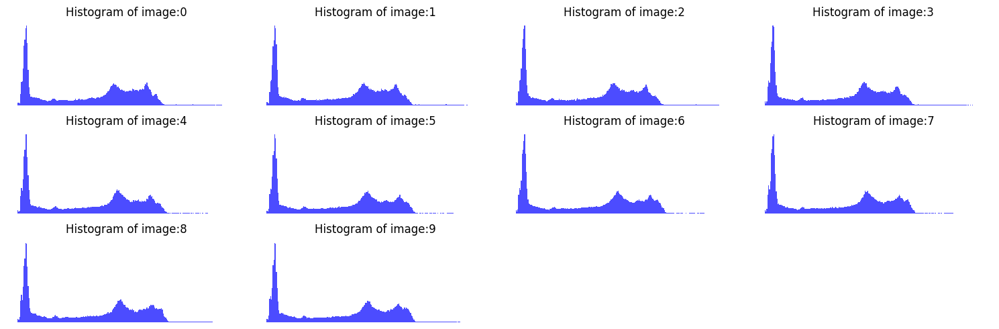

In [13]:
if __name__ =='__main__':
    img_to_hist(Brain_arr)

==================================================================================

In [14]:
## Monitor the each plot closely 
def Indivisual_img_analysis(img:np.array,index:int):
    ## image rescaling between 0 to 255 pixels
    img_arr = img[:,:,index]
    max_pixel = np.max(img_arr)
    min_pixel = np.min(img_arr)
    img_rescaling = ((img_arr - min_pixel)/(max_pixel-min_pixel)*255).astype(np.uint8)
    
    Flat_arr_img0 = img_rescaling.ravel()
    
    Flat_Arr = Flat_arr_img0
    # plt.plot(Flat_arr_img0)
    plt.hist(Flat_arr_img0, bins=256, range=(0, 255), color='blue', alpha=0.7)
    plt.xlim(0, 255)
   
    plt.title(f"Histogram of image :{index}")
    plt.show()

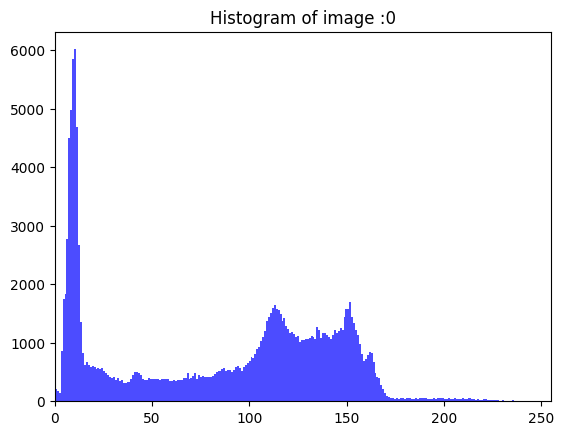

In [15]:
Indivisual_img_analysis(Brain_arr,0)

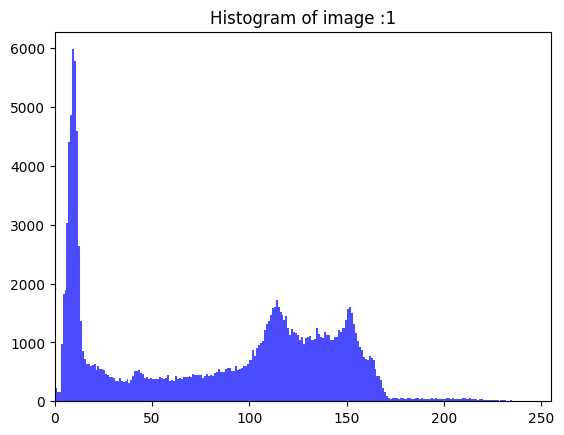

In [16]:
Indivisual_img_analysis(Brain_arr,1)

### Both the histogram have some marginal differences like intensities after 150 and around (~170 px) depth is steep in image 0(slice1) as compare to image 1(slice2)

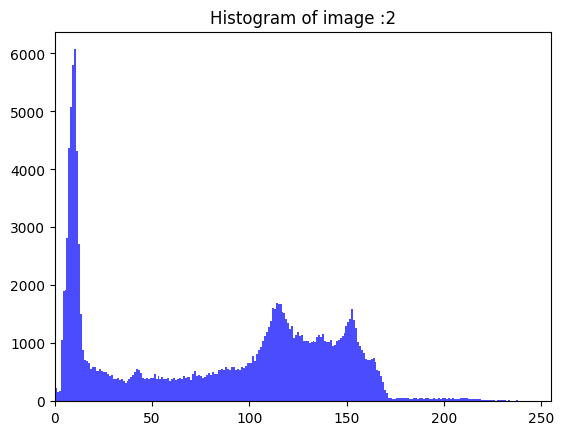

In [17]:
Indivisual_img_analysis(Brain_arr,2)

=====================================================

## Procedure 
<ul>1.I will manually set the threshold for each segment. I will segment the image in 6 parts.</ul>
<ul>2.I will use the thresholds to segment based on the different intensities.</ul>
<ul>3.Visualise the image on the threshold limit.</ul>
<ul>4.Check the accuray.</ul>

## Thresholding methods 
### i) Interactive 
### ii) Otsu thresholding

In [18]:
# • Label 0 = air 
# • Label 1 = skin/scalp
# • Label 2 = skull
# • Label 3 = CSF
# • Label 4 = Gray Matter
# • Label 5 = White Matter

## Thresholding + Interactive method( Segment with manual thresholding)

In [19]:
## I am manually setting some thresholding based on the image 
Threshold_arr = [20,50,100,120,160]

In [20]:
def Indivisual_img_analysis_with_thresholding(img:np.array,index:int,threshold_arr:list):
    ## image rescaling between 0 to 255 pixels
    img_arr = img[:,:,index]
    max_pixel = np.max(img_arr)
    min_pixel = np.min(img_arr)
    img_rescaling = ((img_arr - min_pixel)/(max_pixel-min_pixel)*255).astype(np.uint8)
    
    Flat_arr_img0 = img_rescaling.ravel()
    
    Flat_Arr = Flat_arr_img0
    # plt.plot(Flat_arr_img0)
    plt.hist(Flat_arr_img0, bins=256, range=(0, 255), color='blue', alpha=0.7)
    plt.xlim(0, 255)
    for x in threshold_arr:
        plt.axvline(x=x, color='red', linestyle='--', linewidth=1)
    plt.title(f"Histogram of image :{index}")
    plt.show()

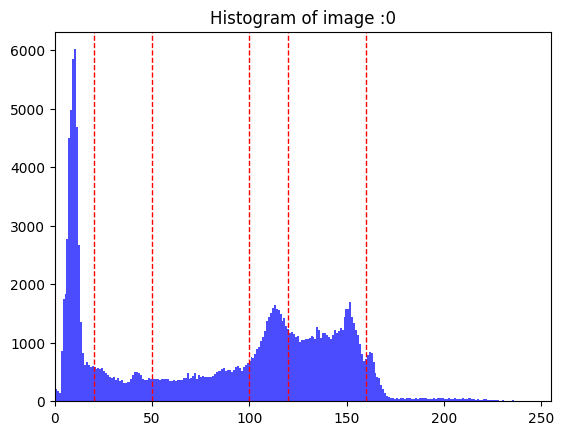

In [21]:
Indivisual_img_analysis_with_thresholding(Brain_arr,0,Threshold_arr )

## Visualizing all the histogram with thresholding

In [22]:
## Semi Automated Method
def img_to_hist_with_thresholding(img:np.array,threshold_arr):
    ## will create the each image to single dim arr
    ## represent each imgae histogram
    plt.figure(figsize=(15, 5))
    no_of_img = img.shape[2]
    for img_index in range(no_of_img):
        img_arr = img[:,:,img_index]
        max_pixel = np.max(img_arr)
        min_pixel = np.min(img_arr)

        img_rescaling = ((img_arr - min_pixel)/(max_pixel-min_pixel)*255).astype(np.uint8)
        ## img_arr.ravel()
        # Flat_img_arr = img_arr.reshape(1,img_arr.shape[0]*img_arr.shape[1])
        Flat_img_arr = img_rescaling.ravel()
        Flat_img_Arr = Flat_img_arr
        plt.subplot(3,4,img_index+1)
        # plt.plot(Flat_img_Arr)
        plt.hist(Flat_img_Arr, bins=256, range=(0, 255), color='blue', alpha=0.7)

        for x in threshold_arr:
            plt.axvline(x=x, color='red', linestyle='--', linewidth=1)
        plt.title(f"Histogram of image:{img_index}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()

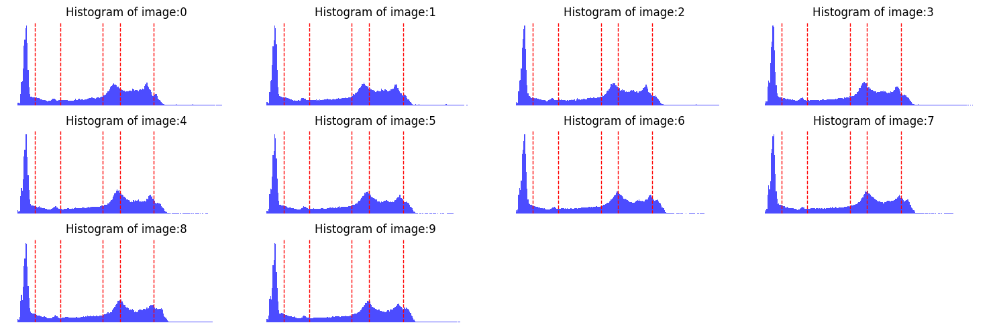

In [23]:

img_to_hist_with_thresholding(Brain_arr,Threshold_arr)

In [24]:
class Interactive_thresholding_with_manual_segmentation:
    def __init__(self,img_arr,threshold_arr):
        self.img_arr = img_arr
        self.threshold_arr = threshold_arr

    def rescaling_image(self,img):
        ## it will take 2d img array as input and will provide 2 d image within 0-255 range 
        max_pixel = np.max(img)
        min_pixel = np.min(img)
        rescaling_img = ((img-min_pixel)/(max_pixel-min_pixel)*255).astype(np.uint8)
        return rescaling_img
        

    def segmentation(self):
        number_of_images = self.img_arr.shape[2]
        arr = []
        arr2 = []
        for each_img_index in range(number_of_images):
             resultant_img = self.img_arr[:,:,each_img_index]
             res_img = self.rescaling_image(resultant_img)
             resultant_img_with_smoothing = res_img
             manual_set_thresholding = [({'lower_bound':bound.split("-")[0] , 'upper_bound':bound.split("-")[1]}) for bound in self.threshold_arr]
            
            
            
            ## Cross checking blog that will check that we are using only 6 segmentation 
             if len(manual_set_thresholding) != 6:
                raise Exception('Not suitable threshold parameter')
                break
            
             bins = [int(th.split('-')[1]) for th in threshold_arr]
             bins.insert(0, 0)
             bins = np.array(bins)
             class_labels = np.digitize(resultant_img_with_smoothing, bins, right=False) - 1
             class_labels[class_labels > 5] = 5
             arr2.append(class_labels)
             
                
                 
        

        

             for bounds in manual_set_thresholding:
                 lower_bound = int(bounds['lower_bound'])
                 upper_bound = int(bounds['upper_bound'])
                
                 ## Here is the corrected version of your sentence:
                 ##"When the conditions are met, I will highlight it with black color; otherwise, with white color."*
                 resultant_image_with_smoothing =  np.where((resultant_img_with_smoothing>lower_bound) & (resultant_img_with_smoothing<=upper_bound),0,255)
                 # print(resultant_image_with_smoothing)
                 arr.append(resultant_image_with_smoothing)

        ## the below code will represent the all 6 segment of each image
        fig, axes = plt.subplots(10, 6, figsize=(20, 30))
        for index_img,ax in enumerate(axes.flat):
 
            ax.imshow(arr[index_img],cmap = plt.cm.gray)
            ax.set_title(f"Seg_Img:{index_img//6}")
        ax.axis('off')
            
        plt.show()
        return arr,arr2
    
                
        

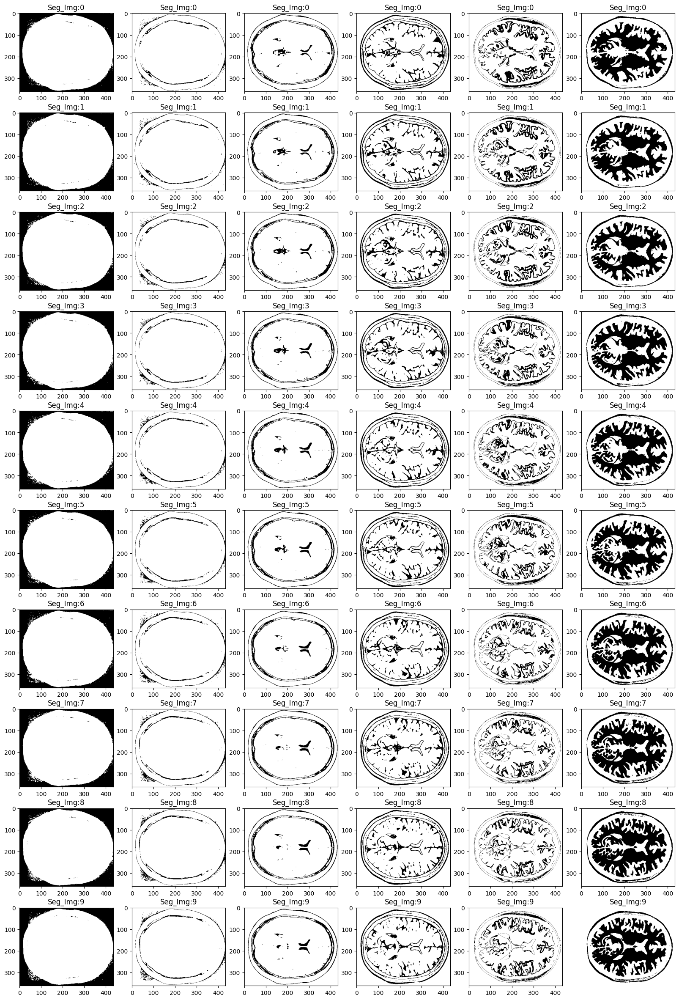

In [25]:

if __name__ == "__main__":
    # threshold_arr = ['0-20','20-50','50-100','100-120','120-160','160-255']
    threshold_arr = ['0-12','12-20','20-50','50-100','100-120','120-255']
    Int_the_with_manual_Seg = Interactive_thresholding_with_manual_segmentation(Brain_arr,threshold_arr)
    Brain_img_seg,brain_img_class_seg = Int_the_with_manual_Seg.segmentation()
    

### The above segment reprsent the 6 different segment for each brain slices (on left to right we have images on different intensities)

In [26]:
## I am also storing the all the segment in one image

## Comparison between actual segment and true label

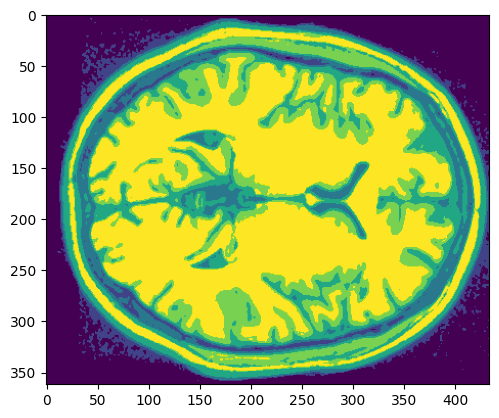

In [27]:
plt.imshow(brain_img_class_seg[0])

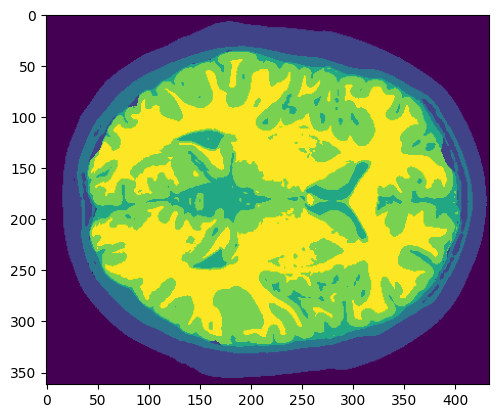

In [28]:
plt.imshow(label[:,:,0])

### Generic Accuracy Measurement 
### I am comparing pixel wise pixel class and try to check the accuracy (I will introduce the accuracy measurement in second segment)

In [28]:
##  I am creating a generic accuray measurement function it will try to match how many classed I predicted accurately 
def generic_accuracy_function(predicted_seg,ground_truth_seg):
 
    total_img = 10
    acc_dict = {}
    for img_index in range(total_img):
        N = 0
        True_label = 0
       
            
        for index in range(ground_truth_seg[:,:,img_index].shape[0]):
            for all_index in range(ground_truth_seg[:,:,img_index][index].shape[0]):
        
                if ground_truth_seg[:,:,img_index][index][all_index] == predicted_seg[img_index][index][all_index]:
                    
                    
                    True_label+=1
               
                N+=1
        acc_dict[f'accuracy_of_img_slice{img_index}'] = (True_label/N)*100
    return acc_dict
         
            

In [30]:
if __name__ == "__main__":
    accuracy_dict = generic_accuracy_function(brain_img_class_seg,label)

In [31]:
accuracy_dict

{'accuracy_of_img_slice0': 64.20869720192479,
 'accuracy_of_img_slice1': 63.91017643913741,
 'accuracy_of_img_slice2': 63.020342694197616,
 'accuracy_of_img_slice3': 62.08086157293072,
 'accuracy_of_img_slice4': 61.266771902131026,
 'accuracy_of_img_slice5': 62.095501183898975,
 'accuracy_of_img_slice6': 61.226672098174504,
 'accuracy_of_img_slice7': 61.15092802403442,
 'accuracy_of_img_slice8': 61.18529928456857,
 'accuracy_of_img_slice9': 62.71227435903965}

In [32]:
np.mean(list(accuracy_dict.values()))

62.285752476003765

#### Average accuracy for all the images is 62.28% 

==================================================================================

## Segmantation with variance minimisation method(Otsu threshold selection algorithm)

In [31]:
from skimage.filters import threshold_multiotsu

In [34]:
def otsu_thresholding(img,index):
    no_of_classes = 6 ## As per the problem statement 
    thresholds = threshold_multiotsu(img[:,:,index], classes=no_of_classes)
    return thresholds

In [35]:
Rec_Brain_arr = Int_the_with_manual_Seg.rescaling_image(Brain_arr)

In [36]:
threshold_arr = otsu_thresholding(Rec_Brain_arr,0)

In [37]:
threshold_arr5 = otsu_thresholding(Rec_Brain_arr,5)

In [38]:
list(threshold_arr)

[29, 66, 101, 133, 175]

In [39]:
list(threshold_arr5)

[29, 66, 101, 133, 174]

### Segmentation with otsu algorithm

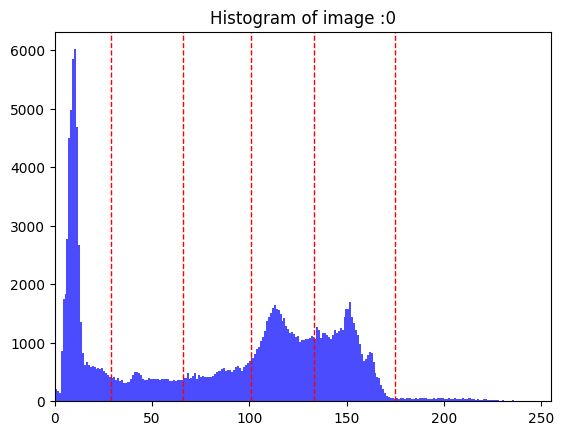

In [40]:
Indivisual_img_analysis_with_thresholding(Brain_arr,0,list(threshold_arr))

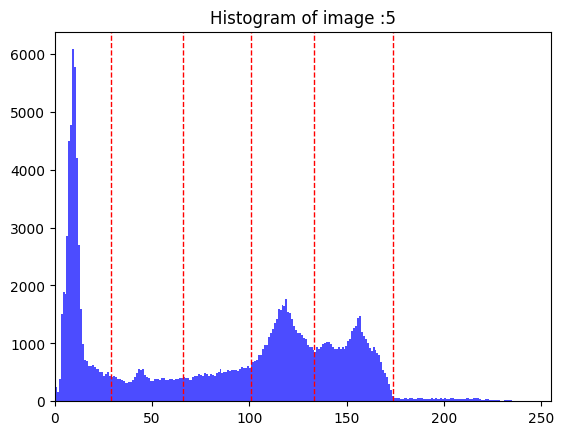

In [41]:
Indivisual_img_analysis_with_thresholding(Brain_arr,5,list(threshold_arr5))

============================================

In [42]:
class Otsu_thresholding_with_manual_segmentation:
    def __init__(self,img_arr):
        self.img_arr = img_arr
        

    def rescaling_image(self,img):
        ## it will take 2d img array as input and will provide 2 d image within 0-255 range 
        max_pixel = np.max(img)
        min_pixel = np.min(img)
        rescaling_img = ((img-min_pixel)/(max_pixel-min_pixel)*255).astype(np.uint8)
        return rescaling_img
        
    def otsu_thresholding(self,img):
        no_of_classes = 6 ## As per the problem statement 
        thresholds = threshold_multiotsu(img, classes=no_of_classes)
        return thresholds
       
        

    def segmentation(self):
        number_of_images = self.img_arr.shape[2]
        arr = []
        arr2 = []
        for each_img_index in range(number_of_images):
             resultant_img = self.img_arr[:,:,each_img_index]
             res_img = self.rescaling_image(resultant_img)
             resultant_img_with_smoothing = res_img
             thresholding_otsu = self.otsu_thresholding(resultant_img_with_smoothing)
             otsu_thresholding = [bound for bound in thresholding_otsu]
            
             otsu_thresholding.insert(0,0)
             otsu_thresholding.append(255)
    
             threshold_arr = [str(otsu_thresholding[index])+'-'+str(otsu_thresholding[index+1]) for index in range(0,len(otsu_thresholding)-1)]
             otsu_set_thresholding = [({'lower_bound':bound.split("-")[0] , 'upper_bound':bound.split("-")[1]}) for bound in threshold_arr]

            
            
            
            ## Cross checking blog that will check that we are using only 6 segmentation 
             if len(otsu_set_thresholding) != 6:
                raise Exception('Not suitable threshold parameter')
                break

            
             bins = [float(th.split('-')[1]) for th in threshold_arr]
             bins.insert(0, 0)
             # print(bins)
             bins = np.array(bins)
             class_labels = np.digitize(resultant_img_with_smoothing, bins, right=False) - 1
             class_labels[class_labels > 5] = 5
             arr2.append(class_labels)
             
                
                 
        

        

             for bounds in  otsu_set_thresholding:
                 lower_bound = float(bounds['lower_bound'])
                 upper_bound = float(bounds['upper_bound'])
                
                 ## Here is the corrected version of your sentence:
                 ##"When the conditions are met, I will highlight it with black color; otherwise, with white color."*
                 resultant_image_with_smoothing =  np.where((resultant_img_with_smoothing>lower_bound) & (resultant_img_with_smoothing<=upper_bound),0,255)
                 # print(resultant_image_with_smoothing)
                 arr.append(resultant_image_with_smoothing)

        ## the below code will represent the all 6 segment of each image
        fig, axes = plt.subplots(10, 6, figsize=(20, 30))
        for index_img,ax in enumerate(axes.flat):
 
            ax.imshow(arr[index_img],cmap = plt.cm.gray)
            ax.set_title(f"Seg_Img:{index_img//6}")
        ax.axis('off')
            
        plt.show()
        return arr,arr2
    
                
        

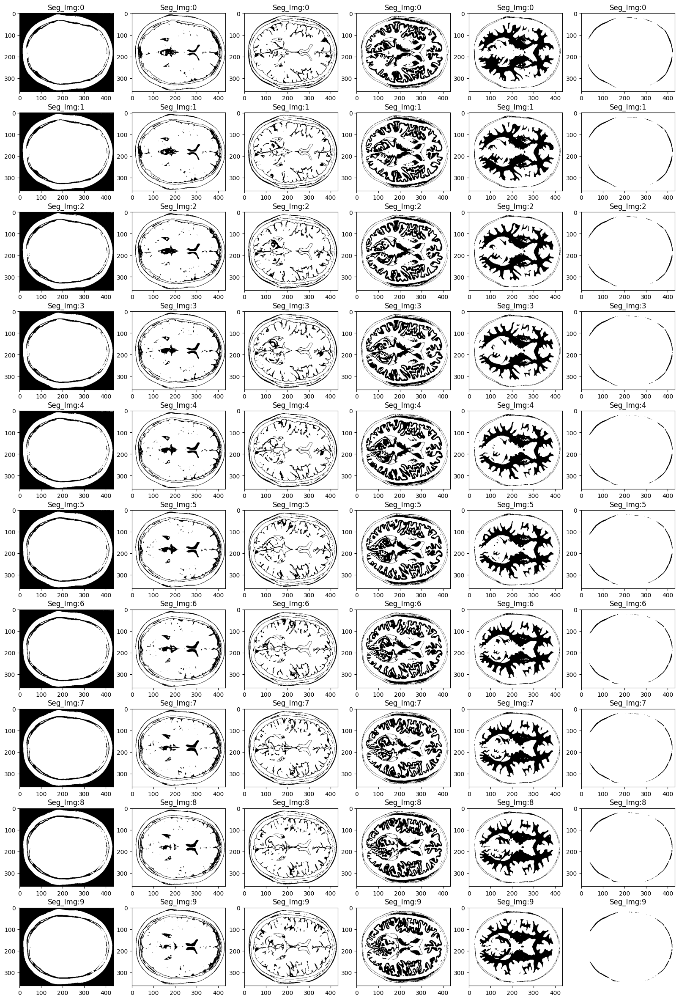

In [43]:
if __name__ == "__main__":
    
    Otsu_seg = Otsu_thresholding_with_manual_segmentation(Brain_arr)
    Brain_img_seg_otsu,brain_img_class_seg_otsu = Otsu_seg.segmentation()
    

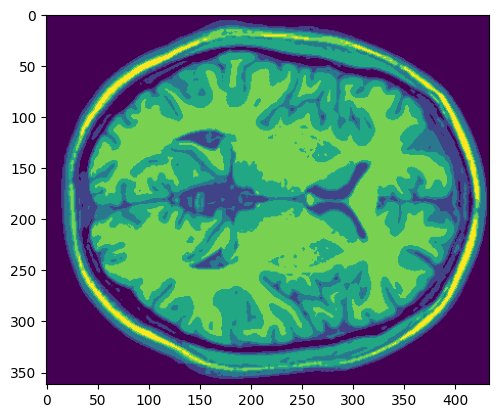

In [44]:
plt.imshow(brain_img_class_seg_otsu[0])

In [45]:
if __name__ == "__main__":
    accuracy_dict_otsu = generic_accuracy_function(brain_img_class_seg_otsu,label)

In [46]:
accuracy_dict_otsu

{'accuracy_of_img_slice0': 29.11245767242916,
 'accuracy_of_img_slice1': 29.417343483463604,
 'accuracy_of_img_slice2': 29.43071008478244,
 'accuracy_of_img_slice3': 29.57901570893907,
 'accuracy_of_img_slice4': 29.540825419456677,
 'accuracy_of_img_slice5': 29.790335310741657,
 'accuracy_of_img_slice6': 29.857168317335848,
 'accuracy_of_img_slice7': 30.173511215215008,
 'accuracy_of_img_slice8': 30.24798227970568,
 'accuracy_of_img_slice9': 29.952007536217124}

In [231]:
accuracy_dict

{'accuracy_of_img_slice0': 64.20869720192479,
 'accuracy_of_img_slice1': 63.91017643913741,
 'accuracy_of_img_slice2': 63.020342694197616,
 'accuracy_of_img_slice3': 62.08086157293072,
 'accuracy_of_img_slice4': 61.266771902131026,
 'accuracy_of_img_slice5': 62.095501183898975,
 'accuracy_of_img_slice6': 61.226672098174504,
 'accuracy_of_img_slice7': 61.15092802403442,
 'accuracy_of_img_slice8': 61.18529928456857,
 'accuracy_of_img_slice9': 62.71227435903965}

==========================================

#### compared to manual thresholding , we are getting less accurate results in otsu threshold method.

==================================================

## Smoothing + Thresholding 

#### I will use different combination steps are as following
<ul><ol>Gaussian filter ( To remove noise)</ol>
<ol>Rescaling the image</ol>
<ol>Use sobel or canny filter </ol>
<ol>Manual/otsu method for thresholding </ol>
</ul> 

In [122]:
smooth_img = skimage.filters.gaussian(Brain_arr,sigma = 2.5)

In [123]:
Rec_Brain_arr_smooth = Int_the_with_manual_Seg.rescaling_image(smooth_img)

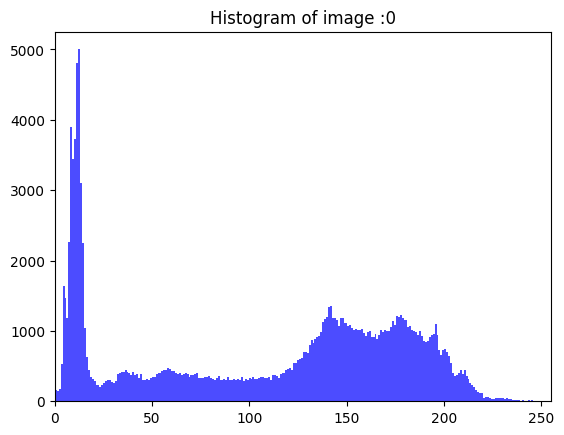

In [124]:
Indivisual_img_analysis(Rec_Brain_arr_smooth,0)

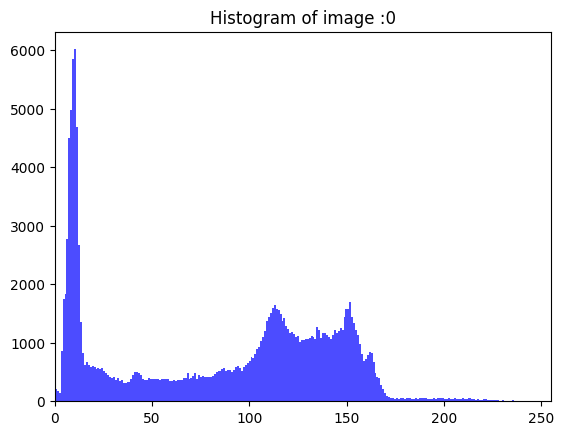

In [125]:
Indivisual_img_analysis(Brain_arr,0)

In [77]:
def rescaling_for_canny(img_arr):
    min_pix = np.min(img_arr)
    max_pix = np.max(img_arr)
    magnitude = (img_arr-min_pix)/(max_pix-min_pix)
    return magnitude

In [ ]:
Manual_thresholding_smoothing = ['0-12','12-20','20-50','50-100','100-120','120-255']

In [126]:
threshold_arr_smoothing0 = otsu_thresholding(Rec_Brain_arr_smooth,0)

In [127]:
threshold_arr_smoothing0 ## sigma 2.5

array([ 33,  76, 118, 154, 184])

In [99]:
threshold_arr_smoothing0 ## at sigma 1

array([ 29,  67, 102, 132, 158])

In [34]:
from skimage import filters, feature, morphology, exposure

class segmentation_with_smoothing_manual_thresholding:
    def __init__(self,img_arr, kernel_name,threshold_arr,sigma):
        self.img_arr = img_arr
        self.kernel_name = [ kernel_name if kernel_name in ('canny','sobel') else 'kernel not supported']
        self.threshold_arr = threshold_arr
        self.sigma = sigma

    def Rescaling_image(self,img:np.array):
        ## it will take 2d img array as input and will provide 2 d image within 0-255 range 
        max_pixel = np.max(img)
        min_pixel = np.min(img)
        rescaling_img = ((img-min_pixel)/(max_pixel-min_pixel)*255).astype(np.uint8)
        return rescaling_img

    def Smoothing_Filter(self,img_arr):

        ## this method is for smoothing the image 
        ## currently I am using only 2 filter canny and sobel so I limit  
        ## my according to the requirement
        
        if self.kernel_name[0] == 'sobel':
            sobel_x = np.array(
                        [[1,0,-1],
                         [2,0,-2],
                         [1,0,-1]])
                        
            sobel_y = np.array(
                        [[1,2,1],
                         [0,0,0],
                         [-1,-2,-1]])
            Gx = scipy.signal.convolve2d(img_arr, sobel_x)
            Gy = scipy.signal.convolve2d(img_arr, sobel_y)

            magnitude = np.sqrt(Gx**2 + Gy**2)

        elif self.kernel_name[0] == 'canny':
            magnitude = skimage.feature.canny(img_arr,sigma = 0.5)
            magnitude = (magnitude*255).astype(np.uint8)

        else:
            raise Exception("Filter support not available")

        return magnitude


    def segmentation_with_visualisation(self):
        ## we will segment each image in six cluster with manually selected threshold 

        number_of_images = self.img_arr.shape[2]
        arr = []
        arr2 = []
        for each_img_index in range(number_of_images):
            
            resultant_img = self.img_arr[:,:,each_img_index]
            ## first gaussian filter -> Rescaling -> canny/sobel filter -> Rescaling -> thresholding 
            gaussian_smoothing_img = skimage.filters.gaussian(resultant_img,sigma =self.sigma)
            
            res_img = self.Rescaling_image(gaussian_smoothing_img)

            resultant_img_with_smoothing = self.Smoothing_Filter(res_img)

            if self.kernel_name[0] == 'sobel':
                res_img_res = self.Rescaling_image(resultant_img_with_smoothing )
                res_img_res = res_img_res[1:-1,1:-1]
            else:
                res_img_res = self.Rescaling_image(resultant_img_with_smoothing )


            

            manual_set_thresholding = [({'lower_bound':bound.split("-")[0] , 'upper_bound':bound.split("-")[1]}) for bound in self.threshold_arr]


            ## Cross checking blog that will check that we are using only 6 segmentation 
            if len(manual_set_thresholding) != 6:
                raise Exception('Not suitable threshold parameter')
                break
            #==================================================#


            bins = [int(th.split('-')[1]) for th in self.threshold_arr]
            bins.insert(0, 0)
            bins = np.array(bins)

            alpha = 0.7  # Weight for smoothed image
            beta = 0.3   # Weight for edge output
            combined_output = alpha * res_img + beta * res_img_res
            combined_img_smootihing = exposure.rescale_intensity(combined_output, in_range='image', out_range=(0, 255))

            
            

           
            
            if self.kernel_name[0] == 'sobel':
                
                class_labels = np.digitize(combined_img_smootihing , bins, right=False) - 1
                
                

                # class_labels[res_img_res]=0
            else:
                ## canny provides the output in o-1 adding gaussian filter with canny
                class_labels = np.digitize(combined_img_smootihing, bins, right=False) - 1
                # class_labels[res_img_res] = -1

            
            class_labels[class_labels > 5] = 5
            arr2.append(class_labels)
            kernel = self.kernel_name[0]
           
            if kernel == 'sobel':                
                
                for bounds in manual_set_thresholding:
                    
                    lower_bound = int(bounds['lower_bound'])
                    upper_bound = int(bounds['upper_bound'])
                    
                    

                    ## Here is the corrected version of your sentence:
                    ##"When the conditions are met, I will highlight it with black color; otherwise, with white color."*
                    # resultant_image_with_smoothing =  np.where((res_img_res>lower_bound) & (res_img_res<=upper_bound),0,255)
                    # res_img
                    sobel_scaled = exposure.rescale_intensity(resultant_img_with_smoothing, in_range='image', out_range=(0, 255))
                    sobel_scaled = sobel_scaled[1:-1,1:-1]
                    
                    resultant_image_with_smoothing =  np.where((res_img_res>0) & (res_img>lower_bound) & (res_img<=upper_bound),sobel_scaled ,255)
    
                    # print(resultant_image_with_smoothing)
                    arr.append(resultant_image_with_smoothing)
                   
                    

            else:
                for bounds in manual_set_thresholding:
                    lower_bound = int(bounds['lower_bound'])
                    upper_bound = int(bounds['upper_bound'])

                    
                    
                    # resultant_image_with_smoothing =  (resultant_img_with_smoothing>lower_bound) & (resultant_img_With_smoothing<=upper_bound)
                    segmented_image = np.where(
                    (res_img_res  >= 0) & (res_img  > lower_bound) & (res_img  <= upper_bound), 
                     resultant_img_with_smoothing,  # Set segmented region to 255 (white) else 0 black
                       255   )
                    arr.append(segmented_image)


        
        fig, axes = plt.subplots(10, 6, figsize=(20, 30))
        for index_img,ax in enumerate(axes.flat):

            ax.imshow(arr[index_img],cmap = plt.cm.gray)
            ax.set_title(f"Seg_Img:{index_img//6}")
        ax.axis('off')
            
        plt.show()
        return arr,arr2
                
                

In [38]:
if __name__ == "__main__":
    threshold_arr = ['0-12','12-20','20-50','50-100','100-120','120-255']
    # threshold_arr = ['0-15','15-22','22-65','65-120','120-150','150-255']
    smoothing_segmentation = segmentation_with_smoothing_manual_thresholding(Brain_arr, 'sobel',threshold_arr,1)

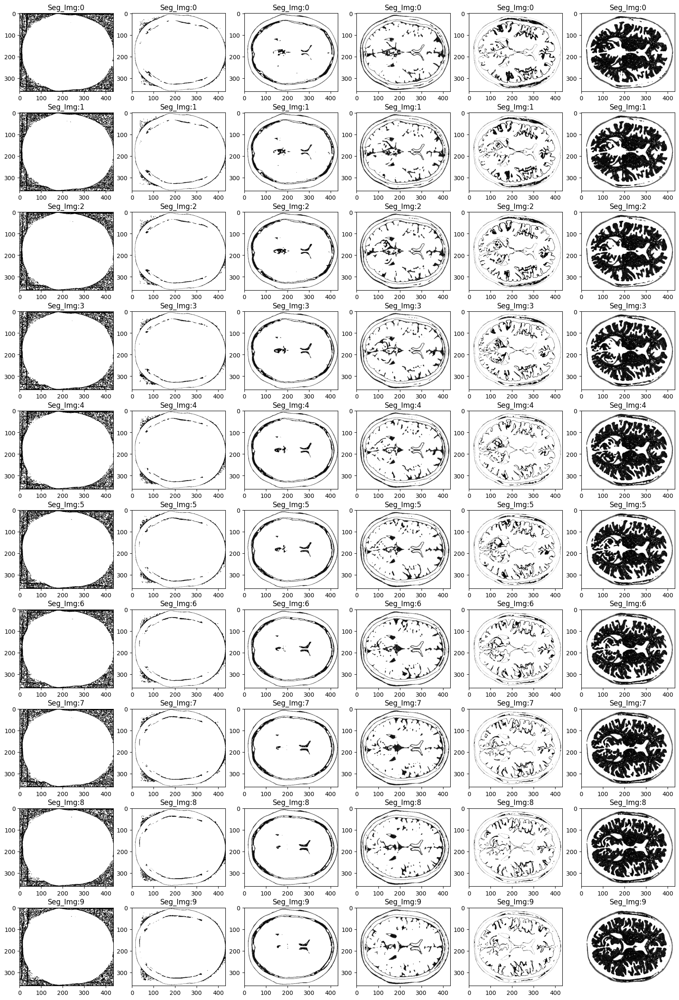

In [39]:
smoothing_arr_seg,arr_seg_shs = smoothing_segmentation.segmentation_with_visualisation()

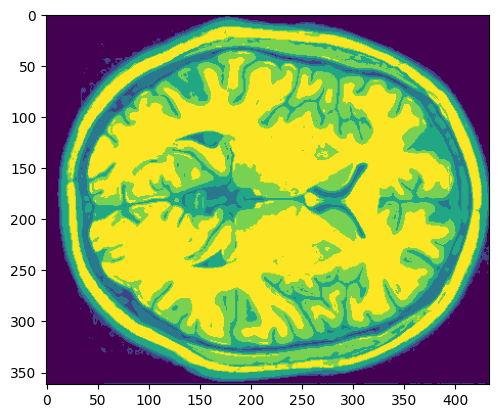

In [320]:
plt.imshow(arr_seg_shs[0])

In [321]:

accuracy_dict_smmothing_gaussian_sobel_man_the = generic_accuracy_function(arr_seg_shs,label)

In [322]:
accuracy_dict_smmothing_gaussian_sobel_man_the

{'accuracy_of_img_slice0': 67.59681238383787,
 'accuracy_of_img_slice1': 67.79476538432161,
 'accuracy_of_img_slice2': 67.232095119281,
 'accuracy_of_img_slice3': 65.49189092853324,
 'accuracy_of_img_slice4': 64.76818494284187,
 'accuracy_of_img_slice5': 64.95977289507854,
 'accuracy_of_img_slice6': 65.81587188430889,
 'accuracy_of_img_slice7': 65.67838684217226,
 'accuracy_of_img_slice8': 64.96741095297503,
 'accuracy_of_img_slice9': 66.15067342210455}

In [323]:
## Average accuracy for all the image slices
np.mean(list(accuracy_dict_smmothing_gaussian_sobel_man_the.values()))


66.04558647554549

==========================================================================

In [324]:
## Canny edge filtering 
if __name__ == "__main__":
    threshold_arr = ['0-12','12-20','20-50','50-100','100-120','120-255']
    smoothing_segmentation_canny = segmentation_with_smoothing_manual_thresholding(Brain_arr, 'canny',threshold_arr,1)

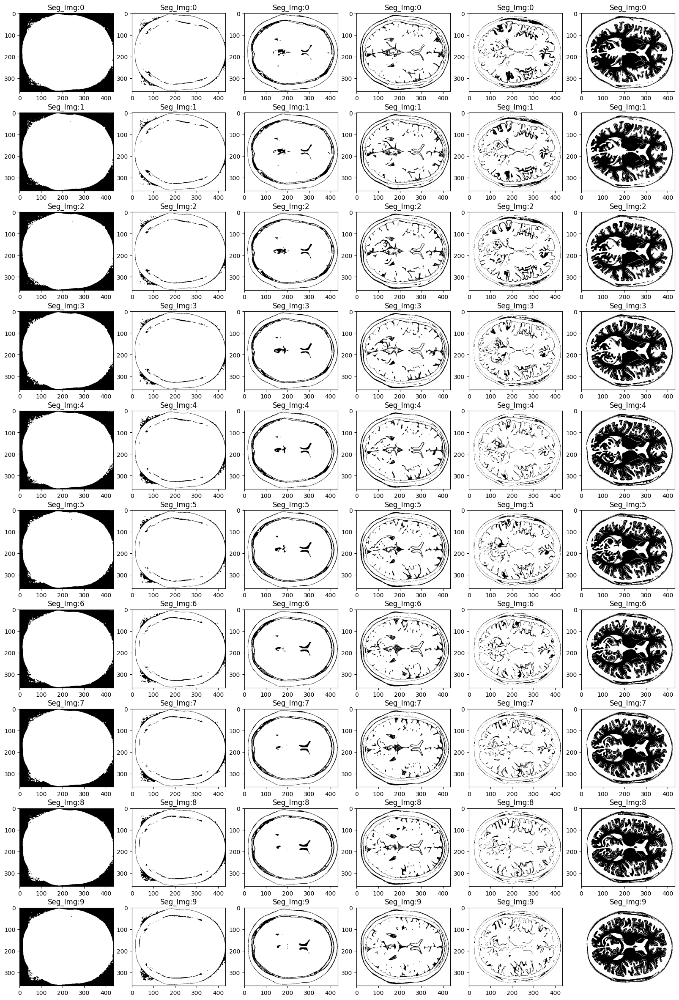

In [325]:
smoothing_arr_seg_canny,arr_seg_shs_canny = smoothing_segmentation_canny.segmentation_with_visualisation()

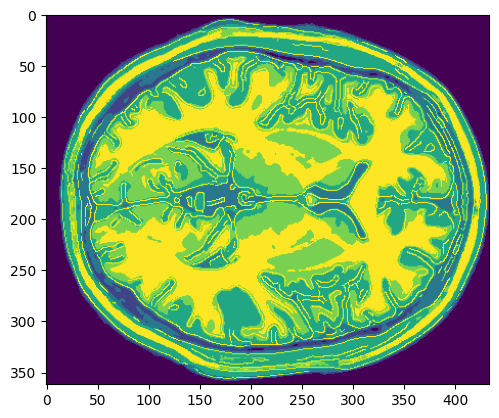

In [326]:
plt.imshow(arr_seg_shs_canny[0])

In [327]:
accuracy_dict_smmothing_gaussian_canny_man_the = generic_accuracy_function(arr_seg_shs_canny,label)

In [328]:
accuracy_dict_smmothing_gaussian_canny_man_the

{'accuracy_of_img_slice0': 55.26835043409629,
 'accuracy_of_img_slice1': 59.46482674338671,
 'accuracy_of_img_slice2': 58.883061333604914,
 'accuracy_of_img_slice3': 57.76726837589429,
 'accuracy_of_img_slice4': 64.7325406726583,
 'accuracy_of_img_slice5': 63.908266924663295,
 'accuracy_of_img_slice6': 64.72872164371006,
 'accuracy_of_img_slice7': 64.5874175726252,
 'accuracy_of_img_slice8': 66.09975303612802,
 'accuracy_of_img_slice9': 66.28624894976703}

In [329]:
## Average accuracy for all the slices
np.mean(list(accuracy_dict_smmothing_gaussian_canny_man_the.values()))

62.17264556865341

==============================================================================

## Smoothing with otsu thresholding 

In [338]:
from skimage import filters, feature, morphology, exposure

class segmentation_with_smoothing_manual_thresholding_otsu:
    def __init__(self,img_arr, kernel_name,sigma):
        self.img_arr = img_arr
        self.kernel_name = [ kernel_name if kernel_name in ('canny','sobel') else 'kernel not supported']
        
        self.sigma = sigma

    def Rescaling_image(self,img:np.array):
        ## it will take 2d img array as input and will provide 2 d image within 0-255 range 
        max_pixel = np.max(img)
        min_pixel = np.min(img)
        rescaling_img = ((img-min_pixel)/(max_pixel-min_pixel)*255).astype(np.uint8)
        return rescaling_img

    def otsu_thresholding(self,img):
        no_of_classes = 6 ## As per the problem statement 
        thresholds = threshold_multiotsu(img, classes=no_of_classes)
        return thresholds

    def Smoothing_Filter(self,img_arr):

        ## this method is for smoothing the image 
        ## currently I am using only 2 filter canny and sobel so I limit  
        ## my according to the requirement
        
        if self.kernel_name[0] == 'sobel':
            sobel_x = np.array(
                        [[1,0,-1],
                         [2,0,-2],
                         [1,0,-1]])
                        
            sobel_y = np.array(
                        [[1,2,1],
                         [0,0,0],
                         [-1,-2,-1]])
            Gx = scipy.signal.convolve2d(img_arr, sobel_x)
            Gy = scipy.signal.convolve2d(img_arr, sobel_y)

            magnitude = np.sqrt(Gx**2 + Gy**2)

        elif self.kernel_name[0] == 'canny':
            magnitude = skimage.feature.canny(img_arr,sigma = 0.5)
            magnitude = (magnitude*255).astype(np.uint8)

        else:
            raise Exception("Filter support not available")

        return magnitude


    def segmentation_with_visualisation(self):
        ## we will segment each image in six cluster with manually selected threshold 

        number_of_images = self.img_arr.shape[2]
        arr = []
        arr2 = []
        for each_img_index in range(number_of_images):
            
            resultant_img = self.img_arr[:,:,each_img_index]
            ## first gaussian filter -> Rescaling -> canny/sobel filter -> Rescaling -> thresholding 
            gaussian_smoothing_img = skimage.filters.gaussian(resultant_img,sigma =self.sigma)
            
            res_img = self.Rescaling_image(gaussian_smoothing_img)

            resultant_img_with_smoothing = self.Smoothing_Filter(res_img)

            thresholding_otsu = self.otsu_thresholding(resultant_img_with_smoothing)
            otsu_thresholding = [bound for bound in thresholding_otsu]
            
            otsu_thresholding.insert(0,0)
            otsu_thresholding.append(255)
    
            threshold_arr = [str(otsu_thresholding[index])+'-'+str(otsu_thresholding[index+1]) for index in range(0,len(otsu_thresholding)-1)]
            otsu_set_thresholding = [({'lower_bound':bound.split("-")[0] , 'upper_bound':bound.split("-")[1]}) for bound in threshold_arr]


            if self.kernel_name[0] == 'sobel':
                res_img_res = self.Rescaling_image(resultant_img_with_smoothing )
                res_img_res = res_img_res[1:-1,1:-1]
            else:
                res_img_res = self.Rescaling_image(resultant_img_with_smoothing )


            

           

            ## Cross checking blog that will check that we are using only 6 segmentation 
            if len(otsu_set_thresholding) != 6:
                raise Exception('Not suitable threshold parameter')
                break
            #==================================================#


            bins = [float(th.split('-')[1]) for th in threshold_arr]
            bins.insert(0, 0)
            bins = np.array(bins)

            alpha = 0.7  # Weight for smoothed image
            beta = 0.3   # Weight for edge output
            combined_output = alpha * res_img + beta * res_img_res
            combined_img_smootihing = exposure.rescale_intensity(combined_output, in_range='image', out_range=(0, 255))

            
            

           
            
            if self.kernel_name[0] == 'sobel':
                
                class_labels = np.digitize(combined_img_smootihing , bins, right=False) - 1
                
                

                # class_labels[res_img_res]=0
            else:
                ## canny provides the output in o-1 adding gaussian filter with canny
                class_labels = np.digitize(combined_img_smootihing, bins, right=False) - 1
                # class_labels[res_img_res] = -1

            
            class_labels[class_labels > 5] = 5
            arr2.append(class_labels)
            kernel = self.kernel_name[0]
           
            if kernel == 'sobel':                
                
                for bounds in otsu_set_thresholding:
                    
                    lower_bound = float(bounds['lower_bound'])
                    upper_bound = float(bounds['upper_bound'])
                    
                    

                    ## Here is the corrected version of your sentence:
                    ##"When the conditions are met, I will highlight it with black color; otherwise, with white color."*
                    # resultant_image_with_smoothing =  np.where((res_img_res>lower_bound) & (res_img_res<=upper_bound),0,255)
                    # res_img
                    sobel_scaled = exposure.rescale_intensity(resultant_img_with_smoothing, in_range='image', out_range=(0, 255))
                    sobel_scaled = sobel_scaled[1:-1,1:-1]
                    
                    resultant_image_with_smoothing =  np.where((res_img_res>0) & (res_img>lower_bound) & (res_img<=upper_bound),sobel_scaled ,255)
    
                    # print(resultant_image_with_smoothing)
                    arr.append(resultant_image_with_smoothing)
                   
                    

            else:
                for bounds in otsu_set_thresholding:
                    lower_bound = float(bounds['lower_bound'])
                    upper_bound = float(bounds['upper_bound'])

                    
                    
                    # resultant_image_with_smoothing =  (resultant_img_with_smoothing>lower_bound) & (resultant_img_With_smoothing<=upper_bound)
                    segmented_image = np.where(
                    (res_img_res  >= 0) & (res_img  > lower_bound) & (res_img  <= upper_bound), 
                     resultant_img_with_smoothing,  # Set segmented region to 255 (white) else 0 black
                       255   )
                    arr.append(segmented_image)


        
        fig, axes = plt.subplots(10, 6, figsize=(20, 30))
        for index_img,ax in enumerate(axes.flat):

            ax.imshow(arr[index_img],cmap = plt.cm.gray)
            ax.set_title(f"Seg_Img:{index_img//6}")
        ax.axis('off')
            
        plt.show()
        return arr,arr2
                
                

In [339]:
if __name__ == "__main__":
    smoothing_segmentation_otsu = segmentation_with_smoothing_manual_thresholding_otsu(Brain_arr, 'sobel',1)

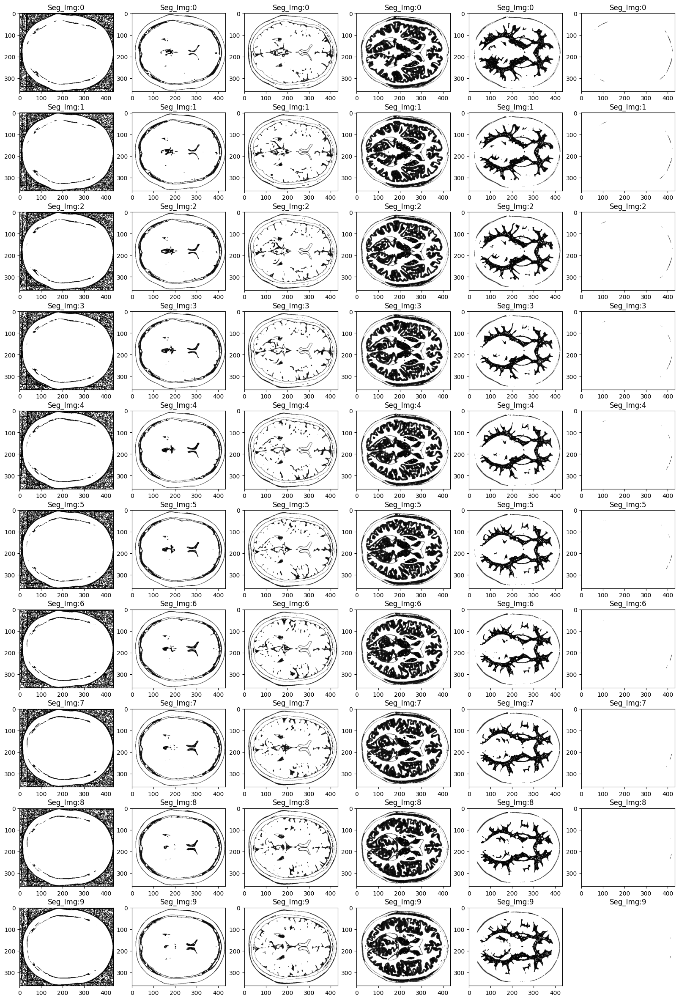

In [340]:
seg_arr_classwise,segmeneted_img_arr_otsu = smoothing_segmentation_otsu.segmentation_with_visualisation()

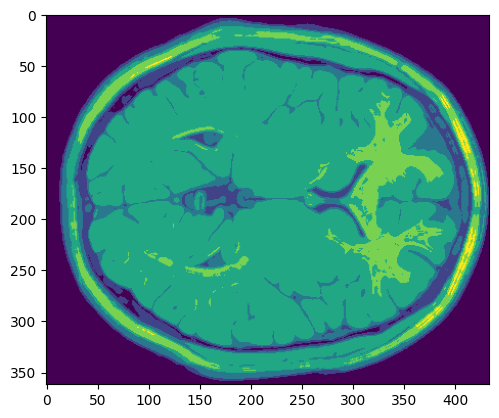

In [341]:
plt.imshow(segmeneted_img_arr_otsu[0])

In [342]:
accuracy_dict_smmothing_gaussian_sobel_man_otsu = generic_accuracy_function(segmeneted_img_arr_otsu,label)

In [343]:
accuracy_dict_smmothing_gaussian_sobel_man_otsu

{'accuracy_of_img_slice0': 26.665096621432387,
 'accuracy_of_img_slice1': 26.581077984571124,
 'accuracy_of_img_slice2': 26.762481859612496,
 'accuracy_of_img_slice3': 26.92479058991267,
 'accuracy_of_img_slice4': 26.983985538610384,
 'accuracy_of_img_slice5': 27.23349542989536,
 'accuracy_of_img_slice6': 27.13611019171525,
 'accuracy_of_img_slice7': 27.390075616773174,
 'accuracy_of_img_slice8': 27.544109784352166,
 'accuracy_of_img_slice9': 27.603941237874587}

=======================================================================================

## K-means clustering 

In [535]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import filters, exposure, morphology
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler



class K_means_segmentation:
    def __init__(self,img_arr,sigma):
        self.img_arr = img_arr
        
        self.sigma = sigma
        


    def Rescaling_image(self,img:np.array):
        ## it will take 2d img array as input and will provide 2 d image within 0-255 range 
        max_pixel = np.max(img)
        min_pixel = np.min(img)
        rescaling_img = ((img-min_pixel)/(max_pixel-min_pixel)*255).astype(np.uint8)
        return rescaling_img


    def Smoothing_Filter(self,img_arr):
        

        ## this method is for smoothing the image 
        ## currently I am using only 2 filter canny and sobel so I limit  
        ## my according to the requirement
        
        if self.kernel_name[0] == 'sobel':
            sobel_x = np.array(
                        [[1,0,-1],
                         [2,0,-2],
                         [1,0,-1]])
                        
            sobel_y = np.array(
                        [[1,2,1],
                         [0,0,0],
                         [-1,-2,-1]])
            Gx = scipy.signal.convolve2d(img_arr, sobel_x)
            Gy = scipy.signal.convolve2d(img_arr, sobel_y)

            magnitude = np.sqrt(Gx**2 + Gy**2)

        elif self.kernel_name[0] == 'canny':
            magnitude = skimage.feature.canny(img_arr,sigma = 0.5)
            magnitude = magnitude.astype(np.uint8)*255
            

        else:
            raise Exception("Filter support not available")

        return magnitude

    def K_means_segmentation_with_visualisation(self):
        number_of_images = self.img_arr.shape[2]
        arr = []
        for each_img_index in range(number_of_images):
            
            resultant_img = self.img_arr[:,:,each_img_index]
            
            gaussian_smoothing_img = skimage.filters.gaussian(resultant_img,sigma =self.sigma)
            normalized_image = exposure.rescale_intensity(gaussian_smoothing_img, in_range='image', out_range=(0, 255))

            sobel_x = filters.sobel_h(normalized_image)
            sobel_y = filters.sobel_v(normalized_image)
            gradient_magnitude = np.hypot(sobel_x, sobel_y)

            flat_intensity = normalized_image.ravel()

            img_arr = self.img_arr
            rows, cols,depth = img_arr.shape
            alpha = 0.95  # Weight for smoothed image
            beta = 0.05  # Weight for edge output
            combined_output = alpha * normalized_image+ beta * gradient_magnitude
            combined_img_smootihing = exposure.rescale_intensity(combined_output, in_range='image', out_range=(0, 255))

            
          

            feature_img =combined_img_smootihing.ravel()
            feature_matrix  = feature_img.reshape(-1,1)
            ## number of cluster 
            k = 6  # Number of clusters for classes 0 to 5
            kmeans = KMeans(n_clusters=k, n_init=10, random_state=42)
            labels = kmeans.fit_predict(feature_matrix)

            

            
           
            segmented_image = labels.reshape(rows, cols)
            

            cluster_means = [flat_intensity[labels == i].mean() for i in range(k)]
            sorted_indices = np.argsort(cluster_means)  # Sort clusters by intensity
            label_mapping = {old_label: new_label for new_label, old_label in enumerate(sorted_indices)}
            standardized_labels = np.vectorize(label_mapping.get)(labels)
            
            # Reshape standardized labels back to image dimensions
            standardized_segmented_image = standardized_labels.reshape(rows, cols)
            


           
            arr.append(standardized_segmented_image )

        fig,ax = plt.subplots(10,2,figsize = (10,30))
        colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b']
        cmap = ListedColormap(colors)
        for index in range(10):
            ax[index,0].imshow(self.img_arr[:,:,index])
            ax[index,0].set_title(f'Slice {index}: Original Image')
            ax[index, 1].imshow(arr[index], cmap='gray')
            # im = ax[index, 1].imshow(arr[index], cmap="tab10")
            # fig.colorbar(im, ax=ax[index, 1]) 
            ax[index,1].set_title(f'Slice {index}: Clustered Image')

        
     

        
        plt.tight_layout()
        plt.show()
        return arr
            
                       
            

        
    

    


    

In [547]:
if __name__ == "__main__":
    Segmentation_kmeans = K_means_segmentation(Brain_arr,3.5)

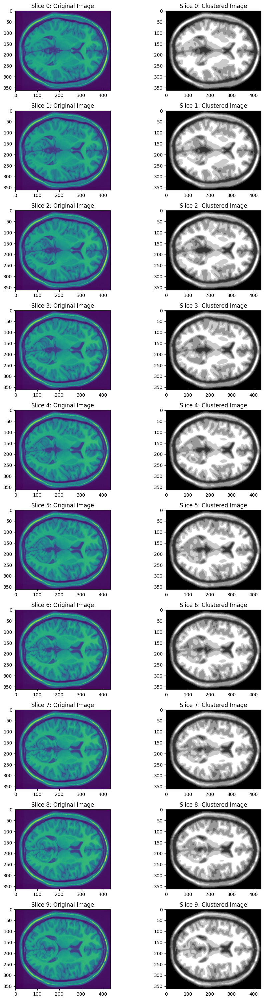

In [548]:
seg_kmeans = Segmentation_kmeans.K_means_segmentation_with_visualisation()

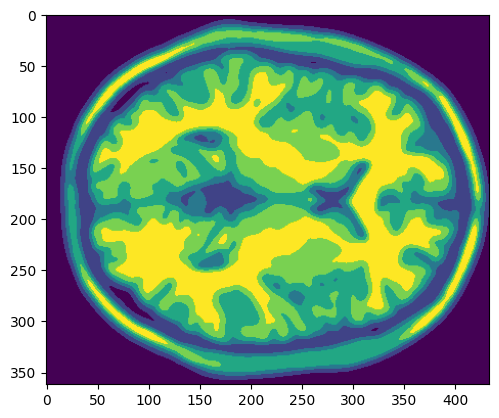

In [549]:
plt.imshow(seg_kmeans[0])

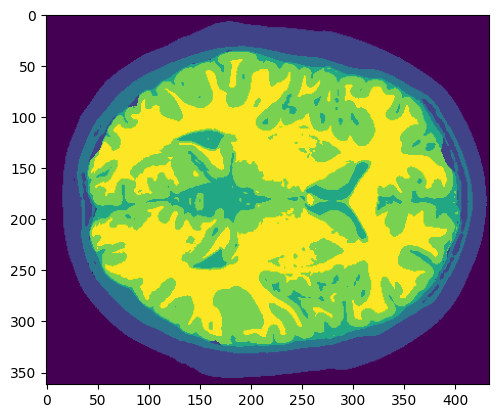

In [546]:
plt.imshow(label[:,:,0])

In [540]:
accuracy_dict_kmeans = generic_accuracy_function(seg_kmeans,label)

In [541]:
accuracy_dict_kmeans

{'accuracy_of_img_slice0': 51.17498790640833,
 'accuracy_of_img_slice1': 52.167935432950586,
 'accuracy_of_img_slice2': 51.58553351834407,
 'accuracy_of_img_slice3': 51.547979733686375,
 'accuracy_of_img_slice4': 54.9685566616595,
 'accuracy_of_img_slice5': 53.59625225959213,
 'accuracy_of_img_slice6': 52.16857193777529,
 'accuracy_of_img_slice7': 52.3054204750872,
 'accuracy_of_img_slice8': 51.79367059602312,
 'accuracy_of_img_slice9': 55.493036637217706}

In [542]:
np.mean(list(accuracy_dict_kmeans.values()))

52.680194515874426

===============================================================

## Task 2 
###  Compare your segmented results for each algorithm to the ground-truth label provided. Justify and explain the metric used to assess accuracy. Based on your evaluation and results, highlight the best algorithm to be used.

## Accuracy measurement

## I will use the image registration technique to check the accuracy between ground label and segmented image
## $$T = \arg \min_p \sum_k \text{sim} \big( I(x_k), J(T_p(x_k)) \big)$$
## I will use affine transformation and similarity tranformation method which is linear transformation method  which is represented by Tp in the above formula
## I will use these methods
<ol>
    Pixel Accuracy
</ol>
<ol>
    Visual overlap
</ol>
<ol>
    MSD
</ol>


## Pixel accuracy 

In [556]:
avg_pixel_acc_smoothing_gaussian_sobel_man_the = np.mean(list(accuracy_dict_smmothing_gaussian_sobel_man_the.values()))
avg_pixel_acc_smoothing_gaussian_canny_man_the = np.mean(list(accuracy_dict_smmothing_gaussian_canny_man_the.values()))
avg_pixel_acc_smoothing_gaussian_kmeans_man_the = np.mean(list(accuracy_dict_kmeans.values()))
                                                         

In [559]:
df = pd.DataFrame()
df['Methods'] = ['thresholding_with_gaussian_denoising_edge_sobel','thresholding_with_gaussian_denoising_edge_canny','k_means']
df['Pixel_accuracy'] = [avg_pixel_acc_smoothing_gaussian_sobel_man_the,avg_pixel_acc_smoothing_gaussian_canny_man_the,avg_pixel_acc_smoothing_gaussian_kmeans_man_the]

In [560]:
display(df)

,Methods,Pixel_accuracy
0,thresholding_with_gaussian_denoising_edge_sobel,66.045586
1,thresholding_with_gaussian_denoising_edge_canny,62.172646
2,k_means,52.680195


========================================================

## Visual overlay 

In [561]:
import cv2
from skimage.measure import find_contours
from skimage.transform import AffineTransform, warp

In [606]:
def visual_overlay(seg_img,ground_truth_img,keypointsA,keypointsB):
    number_of_images = ground_truth_img.shape[2]
    arr = []
    for index in range(number_of_images):
            
        transform = AffineTransform(shear=0.005, rotation=0.005)
        rows, cols = seg_img[index].shape[:2]
        corners = np.array([
        [0, 0],  
        [0, rows],  
        [cols, 0],  
        [cols, rows]  
               ])
        transformed_corners = transform(corners)
        min_row, min_col = np.min(transformed_corners, axis=0)
        max_row, max_col = np.max(transformed_corners, axis=0)
    
        output_rows = int(np.ceil(max_row - min_row))
        output_cols = int(np.ceil(max_col - min_col))
    
        translation = AffineTransform(translation=(-min_row, -min_col))
        adjusted_transform = transform + translation
        
        transform.estimate(np.array(keypointsA), np.array(keypointsB))
        output_shape = ground_truth_img[:,:,index].shape[:2]
        registered_img=warp(seg_img[index], inverse_map=adjusted_transform, output_shape=output_shape)
    
        # registered_img = warp(seg_img, inverse_map=transform.inverse, output_shape=output_shape)
        
        
        # Visual Overlay
        
        img_vis = ground_truth_img[:,:,index]
        overlay = np.zeros((img_vis.shape[0], img_vis.shape[1], 3), dtype=np.float32)
        overlay[..., 0] = img_vis / img_vis.max()  
        overlay[..., 1] = registered_img / registered_img.max() 
        arr.append(overlay)
    
    plt.figure(figsize=(15, 10))  # Adjust the figure size for better visibility

    # Iterate through overlays and create subplots
    for overlay_img_index in range(len(arr)):
        plt.subplot(3, 4, overlay_img_index + 1)  # 3 rows, 4 columns for 12 images
        plt.imshow(arr[overlay_img_index], alpha=0.7)
        plt.title(f"Overlay {overlay_img_index + 1}")
        plt.axis("off")  # Turn off axis for better visualization
    
    plt.tight_layout()  # Automatically adjust subplot spacing
    plt.show()

In [607]:
keypointsA = [[10,50],[25,300],[325,200],[300,250],[250,50],[250,30]]  
 
keypointsB = [[10,50],[25,300],[175,200],[300,250],[250,50],[250,30]]

In [608]:
## we will check with top 3 pixel intensities results 

In [609]:
# arr_seg_shs,arr_seg_shs_canny,seg_kmeans

## Interactive thresholding with sobel filter and guassian denoising filter 

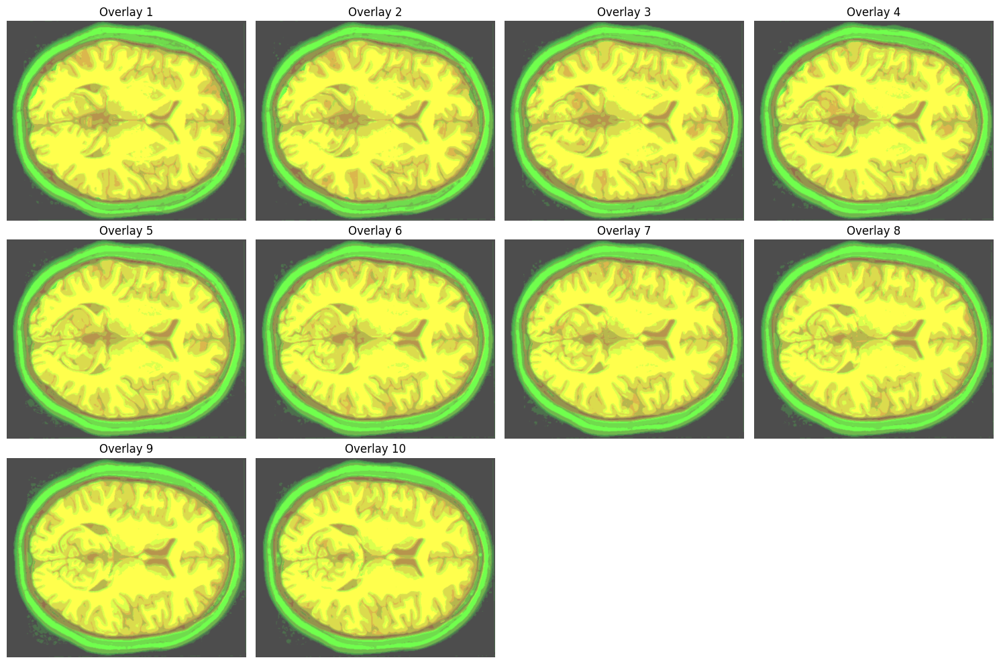

In [610]:
## Visual overlay with interactive thresholding with sobel filter 
visual_overlay(arr_seg_shs,label,keypointsA,keypointsB)

## Interactive thresholding with sobel filter and guassian denoising filter 

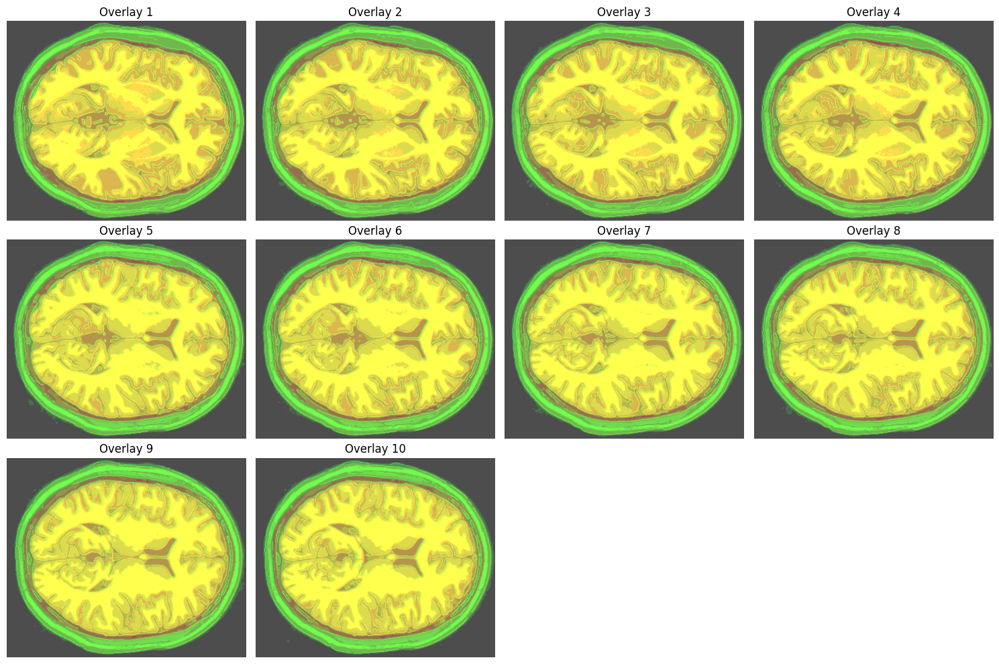

In [611]:
## Visual overlay with interactive thresholding with canny filter 
visual_overlay(arr_seg_shs_canny,label,keypointsA,keypointsB)

## K_means filtering

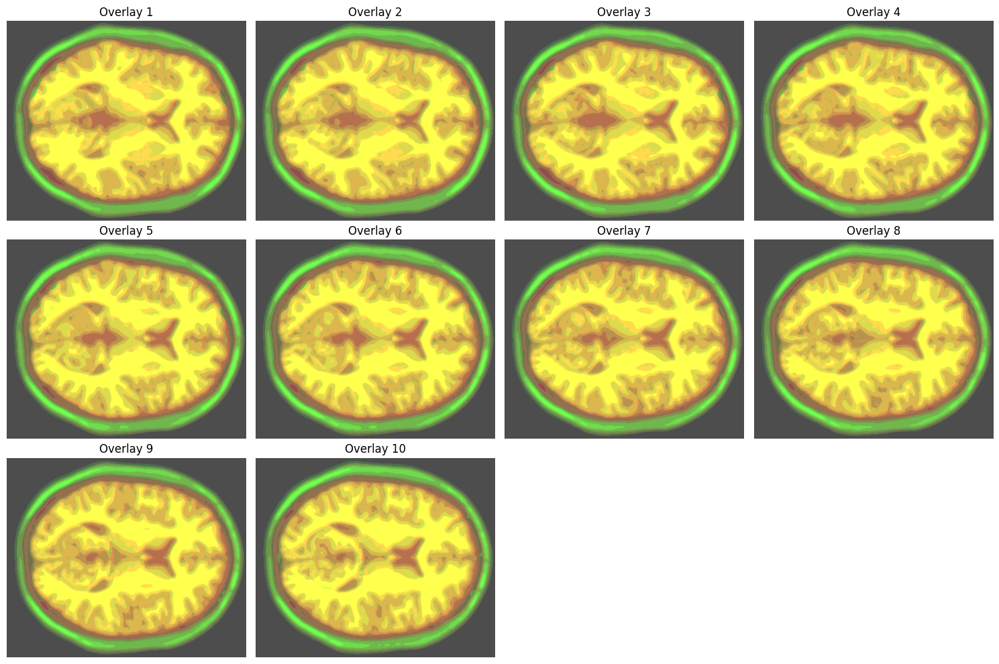

In [612]:
visual_overlay(seg_kmeans,label,keypointsA,keypointsB)

===============================================================

In [627]:
def MSD_SSD_method(ground_truth,segmented_image):
    dict_rmsd = {}
    no_of_images = ground_truth.shape[2]
    
    for index in range(no_of_images):
        
    
        ## msd and ssd is a common method to check the similarity between two images in image registration
        ## the important point is that ground turth and segmented image should be in same range of intensities 
        min_ground = np.min(ground_truth[:,:,index])
        max_ground = np.max(ground_truth[:,:,index])
    
        min_segimg = np.min(segmented_image[index])
        max_segimg = np.max(segmented_image[index])
    
        N = ground_truth[:,:,index].shape[0] * ground_truth[:,:,index].shape[1]
    
        # if max_ground != max_segimg:
        #     print(f"Images are not in same intensities and ground :{max_ground} and seg:{max_segimg}")
        ## converting seg image into same shape as ground label image
        # print(ground_truth.shape)
        # print(segmented_image.shape)

        
        ground_truth_img = ground_truth[:,:,index].ravel()
        seg_image = segmented_image[index].ravel()
        
        # N = len(ground_truth_img)
        N_dash = len(seg_image)
        
        # print(f" dim ground truth :{N} and dim seg img :{N_dash}")
    
        if N!=N_dash:
            
            raise Exception(f"Images are not in same dimension dim {N} and {N_dash}")
        MSD = (1/N) * np.sum(((ground_truth_img) - (seg_image))**2)
        dict_rmsd[f"img_{index}_msd"] = MSD
        
   
    ## less ratio is good 
    return dict_rmsd

In [628]:
k_means_msd =  MSD_SSD_method(label,seg_kmeans)

In [629]:
k_means_msd

{'img_0_msd': 1.1954133462331644,
 'img_1_msd': 1.182861471089951,
 'img_2_msd': 1.2057692797311403,
 'img_3_msd': 1.1847009700333528,
 'img_4_msd': 1.1742304656669298,
 'img_5_msd': 1.173479389973776,
 'img_6_msd': 1.1625506021335643,
 'img_7_msd': 1.1328194617715204,
 'img_8_msd': 1.1290895434987398,
 'img_9_msd': 1.1199493342159534}

In [630]:
canny_msd =  MSD_SSD_method(label,arr_seg_shs_canny)

In [631]:
canny_msd

{'img_0_msd': 1.7065139903760471,
 'img_1_msd': 1.6955979326323294,
 'img_2_msd': 1.6892774397229933,
 'img_3_msd': 1.6851783486518828,
 'img_4_msd': 1.711039539679711,
 'img_5_msd': 1.6959989306718946,
 'img_6_msd': 1.7220256129541462,
 'img_7_msd': 1.680741910023678,
 'img_8_msd': 1.6887364106219926,
 'img_9_msd': 1.684624589454388}

In [633]:
sobel_with_gaussian_msd =  MSD_SSD_method(label,arr_seg_shs)

In [634]:
sobel_with_gaussian_msd

{'img_0_msd': 1.8069990070524735,
 'img_1_msd': 1.794937240624284,
 'img_2_msd': 1.799182727805077,
 'img_3_msd': 1.8746785650635234,
 'img_4_msd': 1.8884397993736795,
 'img_5_msd': 1.8711968836723782,
 'img_6_msd': 1.830575145759605,
 'img_7_msd': 1.8259159304427528,
 'img_8_msd': 1.843375257784454,
 'img_9_msd': 1.820588385059959}

====================================================================================

## 3D Segmenttion

In [26]:
Three_dimensional_brain_img = Brain_arr.ravel()

In [27]:
def Rescaling_image_helper(img:np.array):
    ## it will take 2d img array as input and will provide 2 d image within 0-255 range 
    max_pixel = np.max(img)
    min_pixel = np.min(img)
    rescaling_img = ((img-min_pixel)/(max_pixel-min_pixel)*255).astype(np.uint8)
    return rescaling_img

In [28]:
d3_img = Rescaling_image_helper(Three_dimensional_brain_img)

In [29]:
Threshold_arr = [20,50,100,120,160]

==================================================================================

### Comparison between slice wise histogram and single 3D image histogram

### Slice wise image histograms

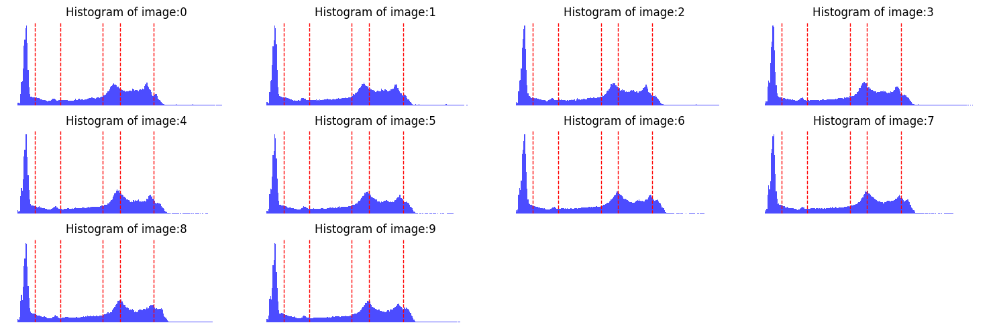

In [30]:
img_to_hist_with_thresholding(Brain_arr,Threshold_arr)

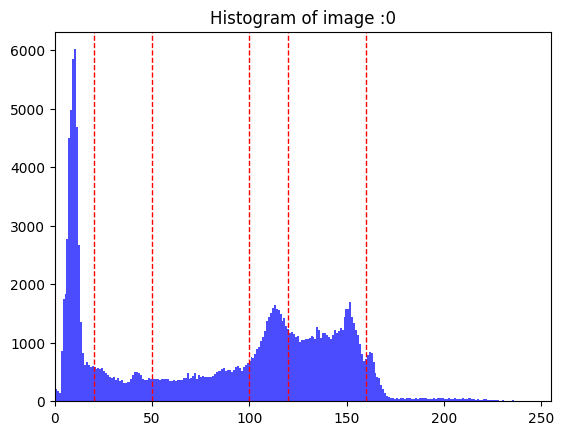

In [31]:
Indivisual_img_analysis_with_thresholding(Brain_arr,0,Threshold_arr)

### 3d Histogram representation

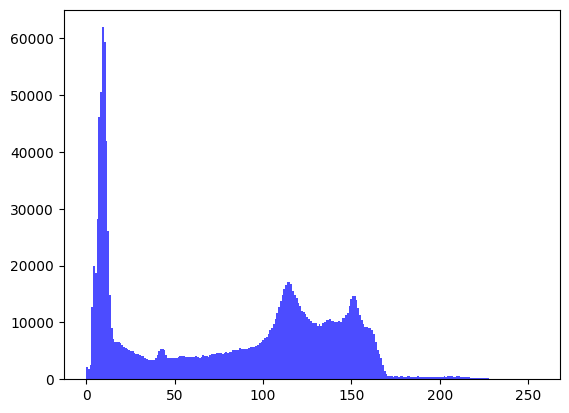

In [32]:
 plt.hist(d3_img, bins=256, range=(0, 255), color='blue', alpha=0.7)
plt.show()

## In 3-d clustering instead of clustering slice wise slice, I will cluster the whole image (x,y,d) and evaluate the results.

In [33]:
# threshold_arr = ['0-12','12-20','20-50','50-100','100-120','120-255']

In [184]:
from scipy.ndimage import gaussian_filter, sobel, label
from skimage import exposure
class segmentation_3d:
    def __init__(self,img_arr, threshold_arr,sigma):
        self.img_arr = img_arr
        self.threshold_arr = threshold_arr
        self.sigma = sigma

    def Rescaling_image(self,img:np.array):
        ## it will take 2d img array as input and will provide 2 d image within 0-255 range 
        max_pixel = np.max(img)
        min_pixel = np.min(img)
        rescaling_img = ((img-min_pixel)/(max_pixel-min_pixel)*255).astype(np.uint8)
        return rescaling_img

    def Segmentation_3d(self):
        ## In the case of 3d I will apply the denoising filter on the whole image 
        ## In this image we have height,width and depth each slices represents the depth
    
         ## Rescale image 
         res_img1 = self.Rescaling_image(self.img_arr)
    
         ## denoising the image
         smoothing_img = gaussian_filter(res_img1,sigma = self.sigma)
         smoothing_img_gaussian = self.Rescaling_image(smoothing_img)
         ## 3d denoising using gaussian filter 
    
         ## Rescaling the image
         res_smoth_img = self.Rescaling_image(smoothing_img)
    
         ## Edge detection algorithm ( I will use sobel )
         sobel_x = sobel(res_smoth_img, axis=0)
         sobel_y = sobel(res_smoth_img, axis=1)
         sobel_z = sobel(res_smoth_img, axis=2)
    
         magnitude_sobel = np.sqrt(sobel_x**2 + sobel_y**2 + sobel_z**2)
         
         alpha = 0.7
         beta = 0.3
         combined_output = alpha * smoothing_img_gaussian + beta * magnitude_sobel
    
         combined_img_smoothing = exposure.rescale_intensity(
            combined_output, in_range=(combined_output.min(), combined_output.max()), out_range=(0, 255)).astype(np.uint8)

         
         bins = [float(th.split('-')[1]) for th in threshold_arr]
         bins.insert(0, 0)
         bins = np.array(bins)
         labeled_volume = np.digitize(combined_img_smoothing, bins=bins)-1
         # labeled_volumn2 = np.digitize(smoothing_img ,bins = bins)-1

        
         return labeled_volume
         

    

In [185]:
if __name__ == "__main__":
    # threshold_arr = ['0-12','12-20','20-50','50-100','100-120','120-255']
    # threshold_arr = ['0-15','15-40','40-75','75-120','120-160','160-255']
    # threshold_arr = ['0-15','15-40','40-75','75-120','120-150','150-255']
    # threshold_arr = ['0-15','15-40','40-65','65-120','120-150','150-255']
    # threshold_arr = ['0-15','15-35','35-65','65-120','120-150','150-255']
    # threshold_arr = ['0-15','15-30','30-65','65-120','120-150','150-255']
    # threshold_arr = ['0-15','15-25','25-65','65-120','120-150','150-255']
    
    # hreshold_arr = ['0-15','15-20','20-65','65-120','120-150','150-255']
    # threshold_arr = ['0-35','35-105','105-117','117-140','140-255'] ## label 1 
    # threshold_arr = ['0-35','35-95','95-110','110-140','140-255']
    # threshold_arr = ['0-35','35-100','100-120','120-150','150-255']
    
    Manual_3d_segmentation = segmentation_3d(Brain_arr,threshold_arr,sigma =1.5)
    
    

In [186]:
segmented_img_3d = Manual_3d_segmentation.Segmentation_3d()

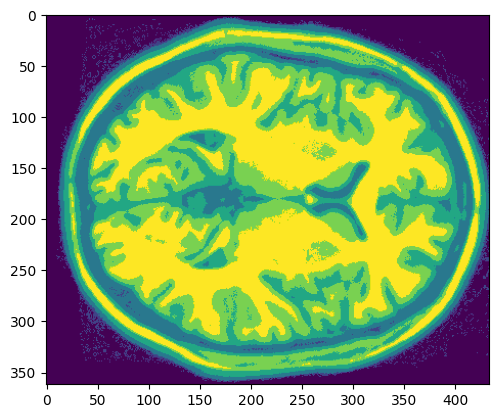

In [187]:
plt.imshow(segmented_img_3d[:,:,0])

In [188]:
label = Brain_image['label']

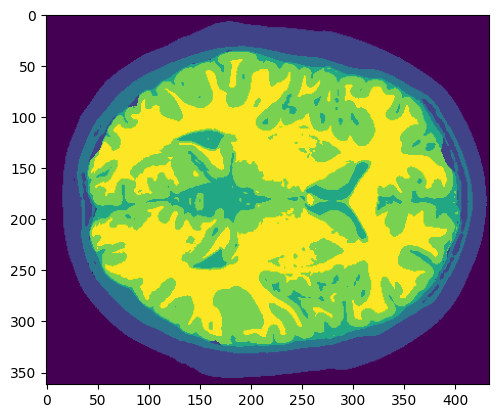

In [189]:
plt.imshow(label[:,:,0]);

In [190]:
def generic_accuracy_function_3d(predicted_seg,ground_truth_seg):
 
    total_img = 10
    acc_dict = {}
    for img_index in range(total_img):
        N = 0
        True_label = 0
       
        
        for index in range(ground_truth_seg[:,:,img_index].shape[0]):
            for all_index in range(ground_truth_seg[:,:,img_index][index].shape[0]):
        
                if ground_truth_seg[:,:,img_index][index][all_index] == predicted_seg[:,:,img_index][index][all_index]:
                    
                    
                    True_label+=1
               
                N+=1
        acc_dict[f'accuracy_of_img_slice{img_index}'] = (True_label/N)*100
    return acc_dict
         
            

In [191]:
accuracy_dict_thre_3d = generic_accuracy_function_3d(segmented_img_3d,label)

In [192]:
accuracy_dict_thre_3d

{'accuracy_of_img_slice0': 68.21549507345266,
 'accuracy_of_img_slice1': 69.57061384525295,
 'accuracy_of_img_slice2': 69.5846169513965,
 'accuracy_of_img_slice3': 68.99266746441938,
 'accuracy_of_img_slice4': 69.17152532016193,
 'accuracy_of_img_slice5': 69.38666395091275,
 'accuracy_of_img_slice6': 69.99770858263106,
 'accuracy_of_img_slice7': 70.25485653181252,
 'accuracy_of_img_slice8': 69.94615169182983,
 'accuracy_of_img_slice9': 69.36820531099626}

## K means Clustering 

In [193]:
from sklearn.cluster import KMeans
class Segment_3d:
    def __init__(self,img_arr,sigma):
        self.img_arr = img_arr
        self.sigma = sigma

    
    def Rescaling_image(self,img:np.array):
        ## it will take 2d img array as input and will provide 2 d image within 0-255 range 
        max_pixel = np.max(img)
        min_pixel = np.min(img)
        rescaling_img = ((img-min_pixel)/(max_pixel-min_pixel)*255).astype(np.uint8)
        return rescaling_img

    def Kmeans_3d_segment(self):
        arr = []
        x,y,d = self.img_arr.shape
        res_img = self.Rescaling_image(self.img_arr)
        smoothing_img = gaussian_filter(res_img,sigma = self.sigma)
        flat_img = smoothing_img.ravel().reshape(-1,1)

       
        k = 6
        kmeans = KMeans(n_clusters = k, random_state = 42,max_iter = 1600,algorithm='elkan')
        labels_ma = kmeans.fit_predict(flat_img)
        labels_ma2 = labels_ma.reshape(x,y,d)
        flat_intensity = flat_img

        cluster_means = [flat_intensity[labels_ma == i].mean() for i in range(k)]
        sorted_indices = np.argsort(cluster_means)  # Sort clusters by intensity
        label_mapping = {old_label: new_label for new_label, old_label in enumerate(sorted_indices)}
        standardized_labels = np.vectorize(label_mapping.get)(labels_ma)
        
        # Reshape standardized labels back to image dimensions
        standardized_segmented_image = standardized_labels.reshape(x, y,d)

        
        return standardized_segmented_image


In [194]:
segment_3d = Segment_3d(Brain_arr,sigma = 2.5)

In [195]:
arr = segment_3d.Kmeans_3d_segment()

In [196]:
np.max(arr)

5

Text(0.5, 1.0, 'segmented image')

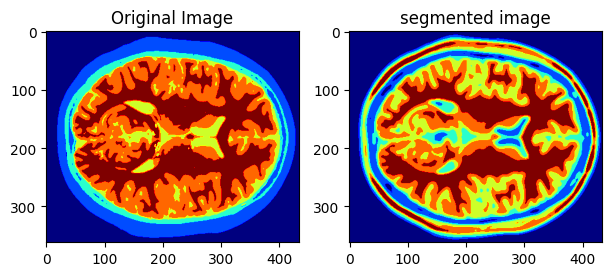

In [197]:
slice_idx = 9 # Example slice index to visualize
plt.figure(figsize=(15, 5))

# Plot original slice
plt.subplot(1, 4, 1)
plt.imshow(label[:, :, slice_idx], cmap='jet')
plt.title('Original Image')

# Plot ground truth
plt.subplot(1, 4, 2)
plt.imshow(arr[:, :, slice_idx], cmap='jet')
plt.title('segmented image')

=========================================================

## Accuracy Measurement in 3D segmentation

In [198]:
accuracy_dict_kmeans_3d = generic_accuracy_function_3d(arr,label)

In [199]:
df_3d = pd.DataFrame()
df_3d['Methods'] = ['Kmean 3d clustering','Smooth Thresholding']
df_3d['Accuracy'] = [np.mean(list(accuracy_dict_kmeans_3d.values())),np.mean(list(accuracy_dict_thre_3d.values()))]

In [200]:
display(df_3d)

,Methods,Accuracy
0,Kmean 3d clustering,56.293951
1,Smooth Thresholding,69.448850


#### Manual thresholding did well and achieved the accuracy of 69.44% and KMeans segmenatation achieved the accuracy of 56.29%

### Image overlay

In [201]:
import cv2
from skimage.measure import find_contours
from skimage.transform import AffineTransform, warp

def visual_overlay_3d(seg_img,ground_truth_img,keypointsA,keypointsB):
    number_of_images = ground_truth_img.shape[2]
    arr = []
    for index in range(number_of_images):
            
        transform = AffineTransform(shear=0.005, rotation=0.005)
        rows, cols = seg_img[index].shape[:2]
        corners = np.array([
        [0, 0],  
        [0, rows],  
        [cols, 0],  
        [cols, rows]  
               ])
        transformed_corners = transform(corners)
        min_row, min_col = np.min(transformed_corners, axis=0)
        max_row, max_col = np.max(transformed_corners, axis=0)
    
        output_rows = int(np.ceil(max_row - min_row))
        output_cols = int(np.ceil(max_col - min_col))
    
        translation = AffineTransform(translation=(-min_row, -min_col))
        adjusted_transform = transform + translation
        
        transform.estimate(np.array(keypointsA), np.array(keypointsB))
        output_shape = ground_truth_img[:,:,index].shape[:2]
        registered_img=warp(seg_img[:,:,index], inverse_map=adjusted_transform, output_shape=output_shape)
    
        # registered_img = warp(seg_img, inverse_map=transform.inverse, output_shape=output_shape)
        
        
        # Visual Overlay
        
        img_vis = ground_truth_img[:,:,index]
        overlay = np.zeros((img_vis.shape[0], img_vis.shape[1], 3), dtype=np.float32)
        overlay[..., 0] = img_vis / img_vis.max()  
        overlay[..., 1] = registered_img / registered_img.max() 
        arr.append(overlay)
    
    plt.figure(figsize=(15, 10))  # Adjust the figure size for better visibility

    # Iterate through overlays and create subplots
    for overlay_img_index in range(len(arr)):
        plt.subplot(3, 4, overlay_img_index + 1)  # 3 rows, 4 columns for 12 images
        plt.imshow(arr[overlay_img_index], alpha=0.7)
        plt.title(f"Overlay {overlay_img_index + 1}")
        plt.axis("off")  # Turn off axis for better visualization
    
    plt.tight_layout()  # Automatically adjust subplot spacing
    plt.show()

In [202]:
keypointsA = [[10,50],[25,300],[325,200],[300,250],[250,50],[250,30]]  
 
keypointsB = [[10,50],[25,300],[175,200],[300,250],[250,50],[250,30]]

## K means clustering 

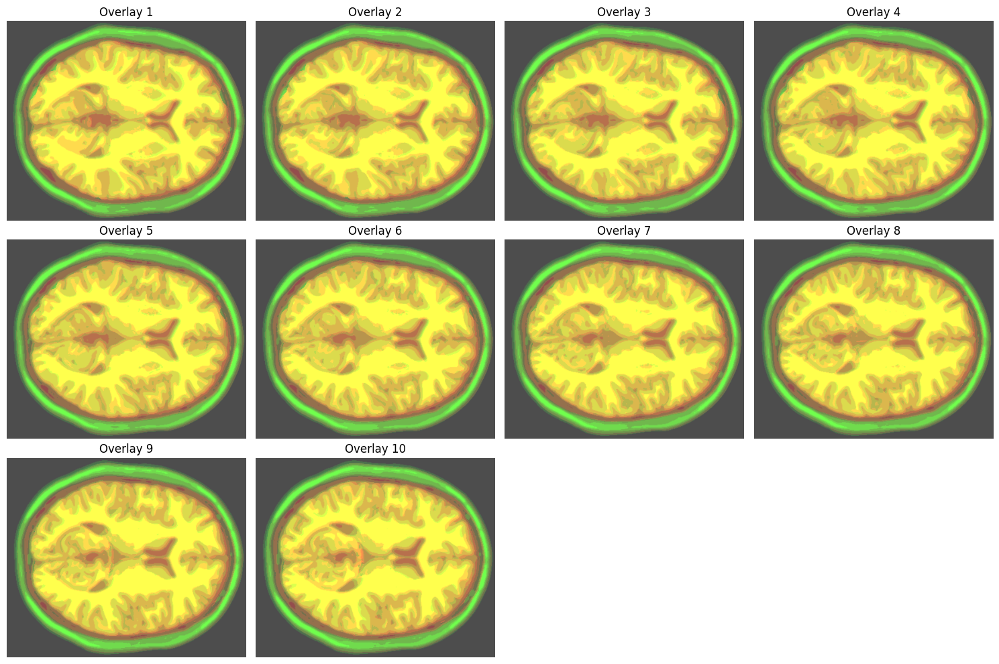

In [203]:
visual_overlay_3d(arr,label,keypointsA,keypointsB)

## Manual thresholding 

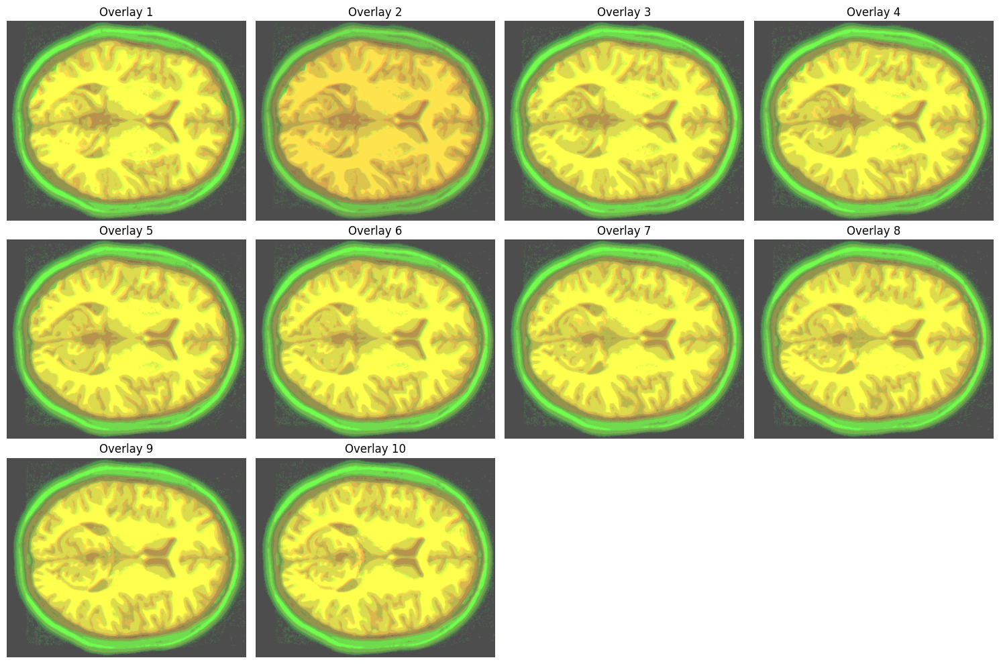

In [204]:

visual_overlay_3d(segmented_img_3d,label,keypointsA,keypointsB)

======================================================================================

## Conclusion 

#### Manual segmenation with gaussian and sobel kernel did well, on one side gaussian kernel reduced the noise from the image and on the other side sobel kernel helps to capture the edges specifically the gray matter lines and achieved the 69.44% accuracy we can refine these approaches more like testing with different thresholding limit and used the combination of otsu and manual intervention to set the threshold limit. We can also try different deep learning model as for the more better results.